In [2]:
import pandas as pd
import chardet
import folium
from openpyxl import load_workbook
import matplotlib.pyplot as plt

In [ ]:
file_path = 'dataFile/Gwangju_Bus_Route_Stop_Time_Based_Passenger_Counts_2024_04.xlsx'

def read_excel_in_chunks(file_path, sheet_name, chunk_size=10000):
    wb = load_workbook(filename=file_path, read_only=True)
    ws = wb[sheet_name]

    rows = ws.iter_rows(values_only=True)
    headers = next(rows)  # 첫 번째 행을 헤더로 사용
    chunks = []

    while True:
        chunk = []
        try:
            for _ in range(chunk_size):
                chunk.append(next(rows))
        except StopIteration:
            if chunk:
                chunks.append(pd.DataFrame(chunk, columns=headers))
            break
        
        chunks.append(pd.DataFrame(chunk, columns=headers))

    return pd.concat(chunks, ignore_index=True)

# 첫 번째 시트를 청크 단위로 읽어오기
sheet_name = '24.4.1.~4.7.'
df = read_excel_in_chunks(file_path, sheet_name, chunk_size=10000)

In [ ]:
# 데이터 프레임의 크기(사이즈)를 확인
data_size = df.shape

# 행과 열의 수를 출력
print(f"Number of rows: {data_size[0]}")
print(f"Number of columns: {data_size[1]}")

# 전처리

## 광주광역시 버스 정류장 2024.04 승하차 엑셀 파일 데이터 합병

In [ ]:
file_path = 'dataFile/Gwangju_Bus_Route_Stop_Time_Based_Passenger_Counts_2024_04.xlsx'

def read_excel_in_chunks(file_path, sheet_name, chunk_size=10000):
    wb = load_workbook(filename=file_path, read_only=True)
    ws = wb[sheet_name]

    rows = ws.iter_rows(values_only=True)
    headers = next(rows)  # 첫 번째 행을 헤더로 사용
    chunks = []

    while True:
        chunk = []
        try:
            for _ in range(chunk_size):
                chunk.append(next(rows))
        except StopIteration:
            if chunk:
                chunks.append(pd.DataFrame(chunk, columns=headers))
            break
        
        if chunk:
            chunks.append(pd.DataFrame(chunk, columns=headers))

    return pd.concat(chunks, ignore_index=True)

# 시트 이름 리스트
sheet_names = ['24.4.1.~4.7.', '24.4.8.~4.14.', '24.4.15.~4.21.', '24.4.22.~4.28.', '24.4.29.~30.']

# 각 시트를 읽어서 DataFrame에 저장
dfs = []
for i, sheet_name in enumerate(sheet_names, start=1):
    df = read_excel_in_chunks(file_path, sheet_name, chunk_size=10000)
    dfs.append(df)
    # DataFrame 저장
    globals()[f'df{i}'] = df

# 각 DataFrame 병합 및 거래건수 합산
def merge_and_aggregate(dfs):
    combined_df = pd.concat(dfs, ignore_index=True)
    # 그룹화 및 거래건수 합산
    merged_df = combined_df.groupby(['노선명', '정류장명', 'ARS_ID', '시간', '승하차']).agg({'거래건수': 'sum'}).reset_index()
    return merged_df

merged_df = merge_and_aggregate(dfs)

# 결과 확인
print(merged_df.head())

In [ ]:
# 데이터 프레임의 크기(사이즈)를 확인
data_size = merged_df.shape

# 행과 열의 수를 출력
print(f"Number of rows: {data_size[0]}")
print(f"Number of columns: {data_size[1]}")

In [ ]:
# 병합된 데이터를 엑셀 파일로 저장
output_file_path = 'dataFile/Merged_Gwangju_Bus_Data_2024_04.xlsx'
merged_df.to_excel(output_file_path, index=False)

print(f"Data has been successfully exported to {output_file_path}")

## 광주광역시 버스 정류장 2024.01 ~ 03 승하차 엑셀 파일 데이터 합병

In [ ]:
file_path = 'dataFile/Gwangju_Bus_Route_Stop_Time_Based_Passenger_Counts_2024_01.xlsx'

def read_excel_in_chunks(file_path, sheet_name, chunk_size=10000):
    wb = load_workbook(filename=file_path, read_only=True)
    ws = wb[sheet_name]

    rows = ws.iter_rows(values_only=True)
    headers = next(rows)  # 첫 번째 행을 헤더로 사용
    chunks = []

    while True:
        chunk = []
        try:
            for _ in range(chunk_size):
                chunk.append(next(rows))
        except StopIteration:
            if chunk:
                chunks.append(pd.DataFrame(chunk, columns=headers))
            break
        
        if chunk:
            chunks.append(pd.DataFrame(chunk, columns=headers))

    return pd.concat(chunks, ignore_index=True)

# 시트 이름 리스트
sheet_names = ['24.1.1.~1.7.', '24.1.8.~1.14.', '24.1.15.~1.21.', '24.1.22.~1.28.', '24.1.29.~1.31.']

# 각 시트를 읽어서 DataFrame에 저장
dfs = []
for i, sheet_name in enumerate(sheet_names, start=1):
    df = read_excel_in_chunks(file_path, sheet_name, chunk_size=10000)
    dfs.append(df)
    # DataFrame 저장
    globals()[f'df{i}'] = df

# 각 DataFrame 병합 및 거래건수 합산
def merge_and_aggregate(dfs):
    combined_df = pd.concat(dfs, ignore_index=True)
    # 그룹화 및 거래건수 합산
    merged_df = combined_df.groupby(['노선명', '정류장명', 'ARS_ID', '시간', '승하차']).agg({'거래건수': 'sum'}).reset_index()
    return merged_df

merged_df = merge_and_aggregate(dfs)

# 병합된 데이터를 엑셀 파일로 저장
output_file_path = 'dataFile/Merged_Gwangju_Bus_Data_2024_01.xlsx'
merged_df.to_excel(output_file_path, index=False)

print(f"Data has been successfully exported to {output_file_path}")

## 광주광역시 버스 정류장 2024.01 ~ 04 승하차 엑셀 파일 합병 데이터 파일 최종 합병

In [ ]:
# 파일 경로 리스트
file_paths = [
    'dataFile/Merged_Gwangju_Bus_Data_2024_01.xlsx',
    'dataFile/Merged_Gwangju_Bus_Data_2024_02.xlsx',
    'dataFile/Merged_Gwangju_Bus_Data_2024_03.xlsx',
    'dataFile/Merged_Gwangju_Bus_Data_2024_04.xlsx'
]

# 각 파일의 데이터를 읽어서 하나의 DataFrame에 병합
combined_dfs = []
for file_path in file_paths:
    df = pd.read_excel(file_path)
    combined_dfs.append(df)

# 모든 파일을 하나의 DataFrame으로 병합
combined_df = pd.concat(combined_dfs, ignore_index=True)

# 거래건수 합산
merged_df = combined_df.groupby(['노선명', '정류장명', 'ARS_ID', '시간', '승하차']).agg({'거래건수': 'sum'}).reset_index()

# 병합된 데이터를 엑셀 파일로 저장
output_file_path = 'dataFile/Merged_Gwangju_Bus_Data_2024_All.xlsx'
merged_df.to_excel(output_file_path, index=False)

print(f"Data has been successfully exported to {output_file_path}")

## 전국 버스 정류장 위치 데이터에서 광주광역시 위치 데이터 추가

In [ ]:
csv_file_path = 'dataFile/MOLIT_National_Bus_Stop_Location_Information_20231016.csv'
excel_file_path = 'dataFile/Merged_Gwangju_Bus_Data_2024_All.xlsx'

# 인코딩 감지
with open(csv_file_path, 'rb') as f:
    result = chardet.detect(f.read())
encoding = result['encoding']
print(f"Detected encoding: {encoding}")

# CSV 파일을 청크 단위로 읽고 필터링
filtered_csv_data = []
chunk_size = 10000

for chunk in pd.read_csv(csv_file_path, encoding=encoding, chunksize=chunk_size):
    filtered_chunk = chunk[(chunk['도시명'] == '광주광역시') & (chunk['관리도시명'] == '광주')]
    filtered_csv_data.append(filtered_chunk)

df_csv_filtered = pd.concat(filtered_csv_data, ignore_index=True)
df_csv_filtered = df_csv_filtered[['모바일단축번호', '위도', '경도']]
print(f"Filtered CSV size: {df_csv_filtered.shape}")

# 엑셀 파일을 청크 단위로 읽고 병합하는 함수
def read_excel_in_chunks(file_path, chunk_size=10000):
    wb = load_workbook(filename=file_path, read_only=True)
    ws = wb.active

    rows = ws.iter_rows(values_only=True)
    headers = next(rows)  # 첫 번째 행을 헤더로 사용
    merged_data = []

    chunk = []
    for i, row in enumerate(rows, 1):
        chunk.append(row)
        if i % chunk_size == 0:
            df_chunk = pd.DataFrame(chunk, columns=headers)
            df_chunk = df_chunk.merge(df_csv_filtered, left_on='ARS_ID', right_on='모바일단축번호', how='left')
            merged_data.append(df_chunk)
            chunk = []

    # 남아있는 마지막 청크 처리
    if chunk:
        df_chunk = pd.DataFrame(chunk, columns=headers)
        df_chunk = df_chunk.merge(df_csv_filtered, left_on='ARS_ID', right_on='모바일단축번호', how='left')
        merged_data.append(df_chunk)

    return pd.concat(merged_data, ignore_index=True)

# 엑셀 파일 데이터를 청크 단위로 읽고 병합
df_merged = read_excel_in_chunks(excel_file_path, chunk_size=10000)

# 병합된 데이터를 엑셀 파일로 저장
output_file_path = 'dataFile/Merged_Gwangju_Bus_Data_With_Coordinates.xlsx'
df_merged.to_excel(output_file_path, index=False)
print(f"Data has been successfully exported to {output_file_path}")

In [ ]:
def read_excel_in_chunks(file_path, chunk_size=10000):
    wb = load_workbook(filename=file_path, read_only=True)
    ws = wb.active  # 첫 번째 시트를 선택

    rows = ws.iter_rows(values_only=True)
    headers = next(rows)  # 첫 번째 행을 헤더로 사용
    chunks = []

    while True:
        chunk = []
        try:
            for _ in range(chunk_size):
                chunk.append(next(rows))
        except StopIteration:
            if chunk:
                chunks.append(pd.DataFrame(chunk, columns=headers))
            break
        
        if chunk:  # Ensure we only append non-empty chunks
            chunks.append(pd.DataFrame(chunk, columns=headers))

    return pd.concat(chunks, ignore_index=True)

# 파일 경로
file_path = 'dataFile/Merged_Gwangju_Bus_Data_With_Coordinates.xlsx'

# 엑셀 파일을 청크 단위로 읽어오기
bus_data_with_coordinates = read_excel_in_chunks(file_path, chunk_size=10000)

bus_data_with_coordinates.head(100)

In [ ]:
# getOn, getOff, transfer 데이터를 필터링하여 각각의 DataFrame으로 분리
getOn_filtered = bus_data_with_coordinates[bus_data_with_coordinates['승하차'] == '승차']
getOff_filtered = bus_data_with_coordinates[bus_data_with_coordinates['승하차'] == '하차']
transfer_filtered = bus_data_with_coordinates[bus_data_with_coordinates['승하차'] == '환승']

# 피벗 테이블 생성 함수
def create_pivot_table(df, label):
    pivot_df = df.pivot_table(
        index=['일자', '노선명', '정류장명', 'ARS_ID', '위도', '경도'],
        columns='시간',
        values='거래건수',
        aggfunc='sum',
        fill_value=0
    )
    pivot_df.columns = [f"{col}시 {label}" for col in pivot_df.columns]
    pivot_df.reset_index(inplace=True)
    pivot_df.columns.name = None
    return pivot_df

# 각 데이터 프레임에 대해 피벗 테이블 생성
getOn_pivot = create_pivot_table(getOn_filtered, '승차인원')
getOff_pivot = create_pivot_table(getOff_filtered, '하차인원')
transfer_pivot = create_pivot_table(transfer_filtered, '환승인원')

# 파일 저장 경로
output_file_path_getOn = 'dataFile/Gwangju_Bus_Data_getOn_Pivot.xlsx'
output_file_path_getOff = 'dataFile/Gwangju_Bus_Data_getOff_Pivot.xlsx'
output_file_path_transfer = 'dataFile/Gwangju_Bus_Data_transfer_Pivot.xlsx'

# 피벗 테이블을 엑셀 파일로 저장
getOn_pivot.to_excel(output_file_path_getOn, index=False)
getOff_pivot.to_excel(output_file_path_getOff, index=False)
transfer_pivot.to_excel(output_file_path_transfer, index=False)

print(f"Data has been successfully exported to {output_file_path_getOn}")
print(f"Data has been successfully exported to {output_file_path_getOff}")
print(f"Data has been successfully exported to {output_file_path_transfer}")

# 분석

In [3]:
getOn_file_path = 'dataFile/Gwangju_Bus_Data_getOn_Pivot.xlsx'
getOff_file_path = 'dataFile/Gwangju_Bus_Data_getOff_Pivot.xlsx'
transfer_file_path = 'dataFile/Gwangju_Bus_Data_transfer_Pivot.xlsx'

getOn_df = pd.read_excel(getOn_file_path)
getOff_df = pd.read_excel(getOff_file_path)
transfer_df = pd.read_excel(transfer_file_path)

# 5시부터 23시까지의 합계 컬럼 생성
getOn_df['총 승차인원'] = getOn_df.loc[:, '5시 승차인원':'23시 승차인원'].sum(axis=1)
getOff_df['총 하차인원'] = getOff_df.loc[:, '5시 하차인원':'23시 하차인원'].sum(axis=1)
transfer_df['총 환승인원'] = transfer_df.loc[:, '5시 환승인원':'23시 환승인원'].sum(axis=1)

## 정류장 승차, 하차, 환승 혼잡도 표 분석 (시간대별 총 )

In [21]:
import matplotlib.colors as mcolors  # 이 줄을 추가하여 mcolors 모듈을 임포트합니다
# 승차 데이터를 분석하기 위한 데이터 프레임 생성
getOn_analyze_tb = getOn_df.drop(['일자', '노선명', '승하차', '위도', '경도'], axis=1)

# 총 승차인원을 기준으로 내림차순 정렬
getOn_analyze_tb = getOn_analyze_tb.sort_values(by='총 승차인원', ascending=False)

# 총 승차인원 컬럼 제거 
getOn_analyze_tb = getOn_analyze_tb.drop('총 승차인원', axis=1)

# 사용자 지정 색상 맵 생성 (흰색에서 파란색으로)
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", ["white", "blue"])

# 배경 그라데이션을 적용할 칼럼 목록
columns_to_style = [col for col in getOn_analyze_tb.columns if col not in ['정류장명', 'ARS_ID']]

# 텍스트 가운데 정렬을 적용할 칼럼 목록
columns_to_align_center = columns_to_style

# 배경 그라데이션 및 텍스트 가운데 정렬 적용
def style_specific_columns(styler):
    styler = styler.background_gradient(cmap=cmap, subset=columns_to_style)
    styler = styler.set_properties(**{'text-align': 'center'}, subset=columns_to_align_center)
    return styler

getOn_analyze_tb_styled = getOn_analyze_tb.style.pipe(style_specific_columns).hide(axis='index')

In [22]:
# 스타일이 적용된 데이터프레임을 HTML 파일로 저장 (UTF-8 인코딩 지정)
html = getOn_analyze_tb_styled.to_html()

# 메타 태그를 추가한 HTML 내용
html_with_meta = '<meta charset="UTF-8">' + html

with open("정류장 승차 인원 혼잡도 표.html", "w", encoding="utf-8") as f:
    f.write(html_with_meta)

print("HTML 파일로 저장되었습니다.")

HTML 파일로 저장되었습니다.


In [23]:
def create_styled_table(df, total_col, output_file, color_map, drop_cols):
    # 데이터를 분석하기 위한 데이터 프레임 생성
    analyze_tb = df.drop(drop_cols, axis=1)

    # 총 인원을 기준으로 내림차순 정렬
    analyze_tb = analyze_tb.sort_values(by=total_col, ascending=False)

    # 총 인원 컬럼 제거 
    analyze_tb = analyze_tb.drop(total_col, axis=1)

    # 배경 그라데이션을 적용할 칼럼 목록
    columns_to_style = [col for col in analyze_tb.columns if col not in ['정류장명', 'ARS_ID']]

    # 텍스트 가운데 정렬을 적용할 칼럼 목록
    columns_to_align_center = columns_to_style

    # 배경 그라데이션 및 텍스트 가운데 정렬 적용
    def style_specific_columns(styler):
        styler = styler.background_gradient(cmap=color_map, subset=columns_to_style)
        styler = styler.set_properties(**{'text-align': 'center'}, subset=columns_to_align_center)
        return styler

    styled_df = analyze_tb.style.pipe(style_specific_columns).hide(axis='index')

    # 스타일이 적용된 데이터프레임을 HTML 파일로 저장 (UTF-8 인코딩 지정)
    html = styled_df.to_html()

    # 메타 태그를 추가한 HTML 내용
    html_with_meta = '<meta charset="UTF-8">' + html

    with open(output_file, "w", encoding="utf-8") as f:
        f.write(html_with_meta)

    print(f"{output_file} 파일로 저장되었습니다.")

# 사용자 지정 색상 맵 생성 (흰색에서 파란색으로)
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", ["white", "blue"])

# 파일 저장
create_styled_table(getOn_df, '총 승차인원', "정류장_승차_인원_혼잡도_표.html", cmap, ['일자', '노선명', '승하차', '위도', '경도'])
create_styled_table(getOff_df, '총 하차인원', "정류장_하차_인원_혼잡도_표.html", cmap, ['일자', '노선명', '승하차', '위도', '경도'])
create_styled_table(transfer_df, '총 환승인원', "정류장_환승_인원_혼잡도_표.html", cmap, ['일자', '노선명', '승하차', '위도', '경도'])

정류장_승차_인원_혼잡도_표.html 파일로 저장되었습니다.
정류장_하차_인원_혼잡도_표.html 파일로 저장되었습니다.
정류장_환승_인원_혼잡도_표.html 파일로 저장되었습니다.


## 버스 정류장 승하차 수에 따른 맵 지정

In [27]:
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

# 중심점을 설정 (정류장명이 '구시청사거리'인 정류장의 위도, 경도)
center_lat = getOn_df[getOn_df['정류장명'] == '구시청사거리']['위도'].values[0]
center_lon = getOn_df[getOn_df['정류장명'] == '구시청사거리']['경도'].values[0]

center = [center_lat, center_lon]

# 지도 생성
m = folium.Map(location=center, zoom_start=11)

# 마커 클러스터링 사용
marker_cluster = MarkerCluster().add_to(m)

# 최대값과 최소값 계산
min_count = getOn_df['총 승차인원'].min()
max_count = getOn_df['총 승차인원'].max()

# 색상 맵 생성 (흰색에서 파란색으로)
def get_color(count):
    interval = (max_count - min_count) / 3
    if count < min_count + interval:
        return 'green'
    elif count < min_count + 2 * interval:
        return 'orange'
    else:
        return 'red'

# 데이터 준비 및 원형 마커 추가
for index, row in getOn_df.iterrows():
    folium.CircleMarker(
        location=(row['위도'], row['경도']),
        radius=row['총 승차인원'] / 50,  # 승차인원에 따라 원의 크기 조절
        color=get_color(row['총 승차인원']),
        fill=True,
        fill_color=get_color(row['총 승차인원']),
        fill_opacity=0.6,
        popup=(
            f"<strong>정류장명:</strong> {row['정류장명']}<br>"
            f"<strong>총 승차인원:</strong> {row['총 승차인원']}명<br>"
        )
    ).add_to(marker_cluster)
    folium.Marker(
        location=(row['위도'], row['경도']),
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12px; color: black;">{row["총 승차인원"]}</div>'
        )
    ).add_to(marker_cluster)

# 지도 저장
m.save('2024 승차인원 포화상태.html')

m

## 승차 출근, 퇴근 시간 혼잡도(표, 막대 그래프)

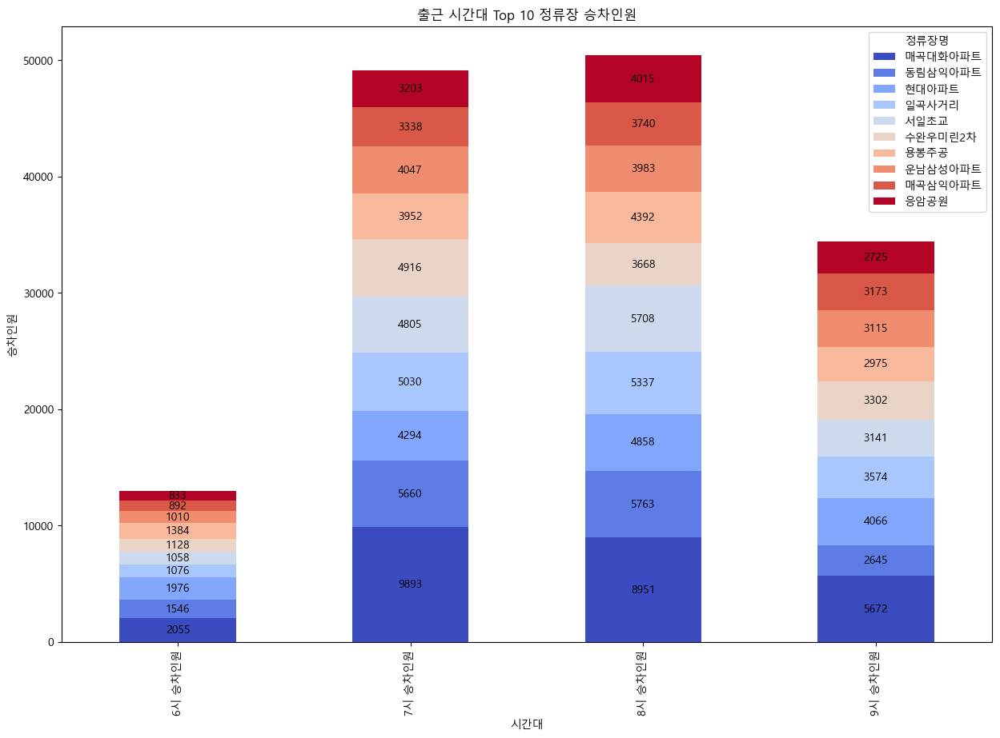

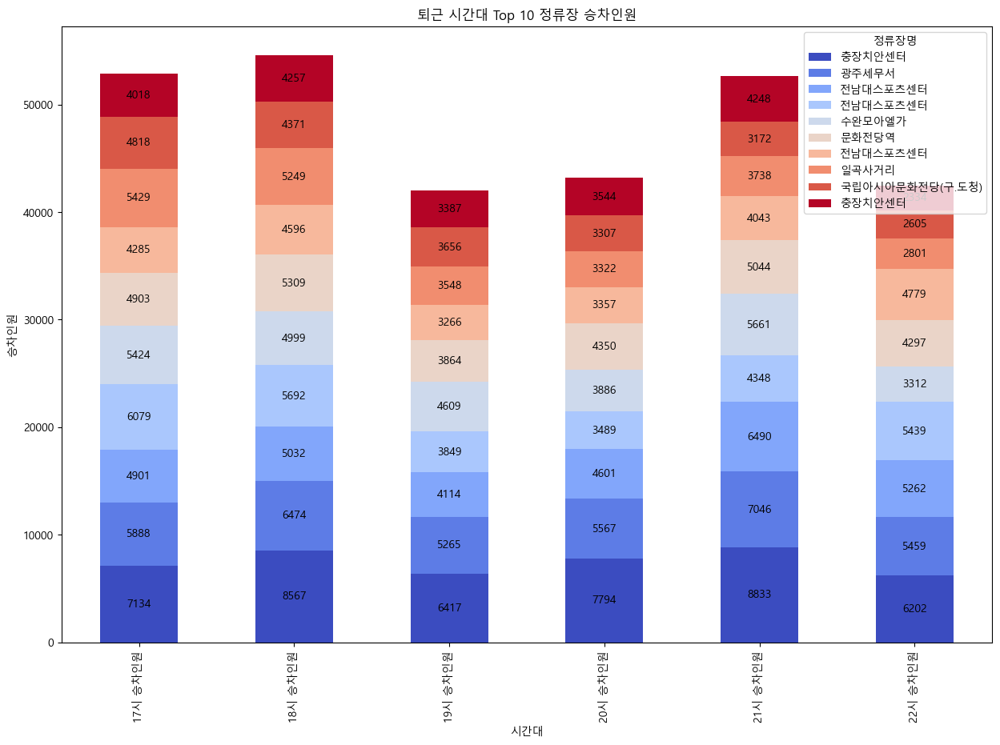

In [34]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import matplotlib.colors as mcolors
import numpy as np

# 한글 폰트 설정
font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우 시스템에서 '맑은 고딕' 폰트 경로
font_name = fm.FontProperties(fname=font_path).get_name()
plt.rc('font', family=font_name)

# 출근 시간과 퇴근 시간 동안의 승차 인원을 계산
getOn_df['출근 시간 총 승차인원'] = getOn_df[['6시 승차인원', '7시 승차인원', '8시 승차인원', '9시 승차인원']].sum(axis=1)
getOn_df['퇴근 시간 총 승차인원'] = getOn_df[['17시 승차인원', '18시 승차인원', '19시 승차인원', '20시 승차인원', '21시 승차인원', '22시 승차인원']].sum(axis=1)

# 출근 시간 기준으로 Top 10 정류장 선정
top_10_morning = getOn_df.nlargest(10, '출근 시간 총 승차인원')

# 퇴근 시간 기준으로 Top 10 정류장 선정
top_10_evening = getOn_df.nlargest(10, '퇴근 시간 총 승차인원')

# 색상 설정을 위한 함수
def get_colors(values):
    norm = mcolors.Normalize(vmin=values.min(), vmax=values.max())
    cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", ["gray", "blue"])
    return [cmap(norm(val)) for val in values]

# Top 10 정류장의 시간대별 승차 인원수 시각화
def plot_top_10(df, title):
    df.set_index('정류장명', inplace=True)
    
    if title == '출근 시간대 Top 10 정류장 승차인원':
        columns_to_plot = ['6시 승차인원', '7시 승차인원', '8시 승차인원', '9시 승차인원']
    elif title == '퇴근 시간대 Top 10 정류장 승차인원':
        columns_to_plot = ['17시 승차인원', '18시 승차인원', '19시 승차인원', '20시 승차인원', '21시 승차인원', '22시 승차인원']
    else:
        print("error")
        return
    
    if columns_to_plot:
        ax = df[columns_to_plot].T.plot(kind='bar', stacked=True, figsize=(15, 10), colormap='coolwarm')
        plt.title(title)
        plt.ylabel('승차인원')
        plt.xlabel('시간대')
        plt.legend(title='정류장명')
        
        # 각 막대 위에 텍스트 추가
        for container in ax.containers:
            ax.bar_label(container, label_type='center')
        
        plt.show()

plot_top_10(top_10_morning, '출근 시간대 Top 10 정류장 승차인원')
plot_top_10(top_10_evening, '퇴근 시간대 Top 10 정류장 승차인원')


In [12]:
# 출근 시간과 퇴근 시간 동안의 승차 인원을 계산
getOn_df['출근 시간 총 승차인원'] = getOn_df[['6시 승차인원', '7시 승차인원', '8시 승차인원', '9시 승차인원']].sum(axis=1)
getOn_df['퇴근 시간 총 승차인원'] = getOn_df[['17시 승차인원', '18시 승차인원', '19시 승차인원', '20시 승차인원', '21시 승차인원', '22시 승차인원']].sum(axis=1)

# 출근 시간 기준으로 Top 10 정류장 선정
top_10_morning = getOn_df.nlargest(10, '출근 시간 총 승차인원')

# 퇴근 시간 기준으로 Top 10 정류장 선정
top_10_evening = getOn_df.nlargest(10, '퇴근 시간 총 승차인원')

# Top 10 정류장의 시간대별 승차 인원수를 표로 표시
def display_top_10_table(df, title):
    if '출근 시간' in title:
        columns_to_show = ['정류장명', '6시 승차인원', '7시 승차인원', '8시 승차인원', '9시 승차인원', '출근 시간 총 승차인원']
    elif '퇴근 시간' in title:
        columns_to_show = ['정류장명', '17시 승차인원', '18시 승차인원', '19시 승차인원', '20시 승차인원', '21시 승차인원', '22시 승차인원', '퇴근 시간 총 승차인원']
    else:
        columns_to_show = []
    
    if columns_to_show:
        display_df = df[columns_to_show].copy()
        display_df.set_index('정류장명', inplace=True)
        display_df.style.set_caption(title).format(na_rep='-')

        return display_df

# 출근 시간대 Top 10 정류장 표
morning_table = display_top_10_table(top_10_morning, '출근 시간대 Top 10 정류장 승차인원')

# 퇴근 시간대 Top 10 정류장 표
evening_table = display_top_10_table(top_10_evening, '퇴근 시간대 Top 10 정류장 승차인원')

In [13]:
morning_table

,6시 승차인원,7시 승차인원,8시 승차인원,9시 승차인원,출근 시간 총 승차인원
정류장명,,,,,
매곡대화아파트,2055,9893,8951,5672,26571
동림삼익아파트,1546,5660,5763,2645,15614
현대아파트,1976,4294,4858,4066,15194
일곡사거리,1076,5030,5337,3574,15017
서일초교,1058,4805,5708,3141,14712
수완우미린2차,1128,4916,3668,3302,13014
용봉주공,1384,3952,4392,2975,12703
운남삼성아파트,1010,4047,3983,3115,12155
매곡삼익아파트,892,3338,3740,3173,11143


In [14]:
evening_table

,17시 승차인원,18시 승차인원,19시 승차인원,20시 승차인원,21시 승차인원,22시 승차인원,퇴근 시간 총 승차인원
정류장명,,,,,,,
충장치안센터,7134,8567,6417,7794,8833,6202,44947
광주세무서,5888,6474,5265,5567,7046,5459,35699
전남대스포츠센터,4901,5032,4114,4601,6490,5262,30400
전남대스포츠센터,6079,5692,3849,3489,4348,5439,28896
수완모아엘가,5424,4999,4609,3886,5661,3312,27891
문화전당역,4903,5309,3864,4350,5044,4297,27767
전남대스포츠센터,4285,4596,3266,3357,4043,4779,24326
일곡사거리,5429,5249,3548,3322,3738,2801,24087
국립아시아문화전당(구.도청),4818,4371,3656,3307,3172,2605,21929


## 하차 출근, 퇴근 시간 혼잡도(표, 막대 그래프)

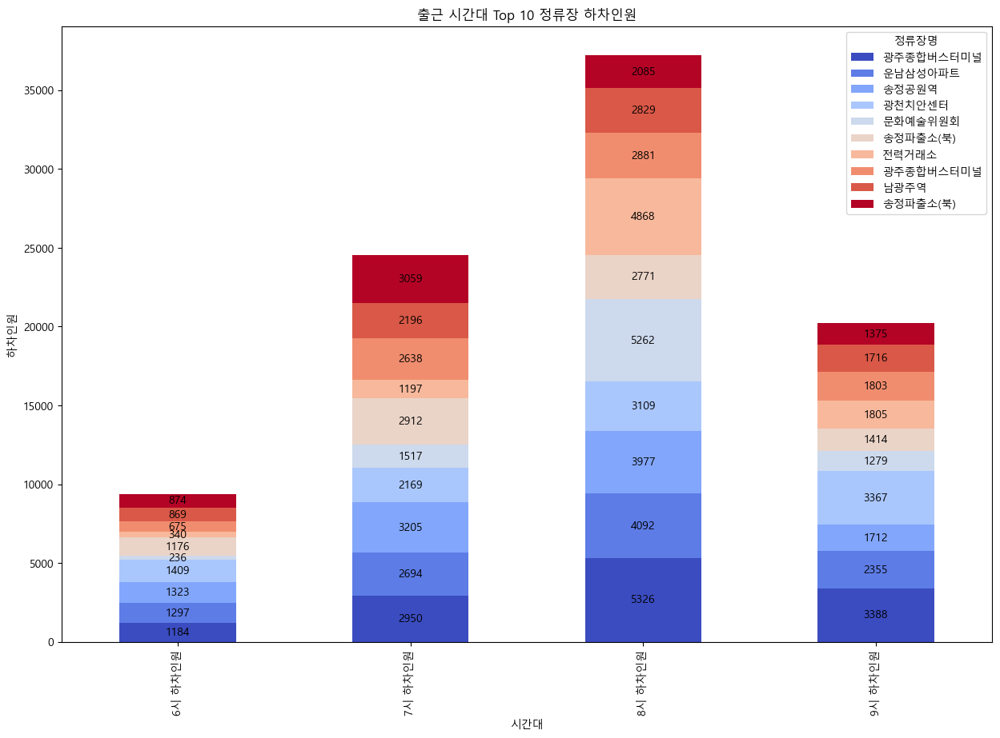

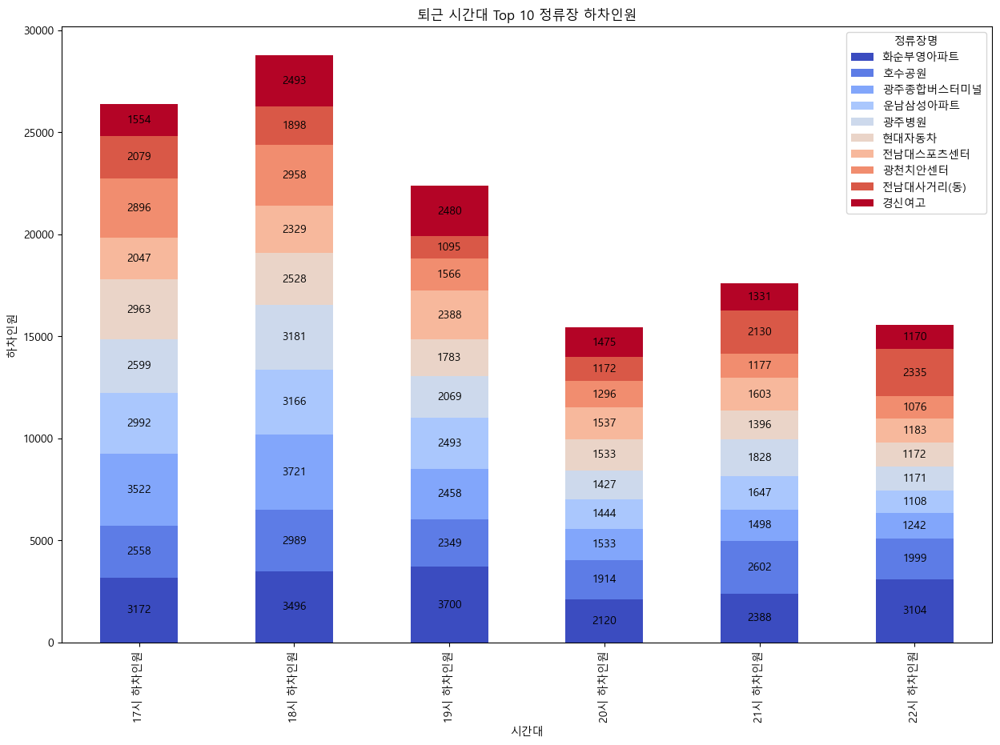

In [35]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import matplotlib.colors as mcolors
import numpy as np

# 한글 폰트 설정
font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우 시스템에서 '맑은 고딕' 폰트 경로
font_name = fm.FontProperties(fname=font_path).get_name()
plt.rc('font', family=font_name)

# 출근 시간과 퇴근 시간 동안의 하차 인원을 계산
getOff_df['출근 시간 총 하차인원'] = getOff_df[['6시 하차인원', '7시 하차인원', '8시 하차인원', '9시 하차인원']].sum(axis=1)
getOff_df['퇴근 시간 총 하차인원'] = getOff_df[['17시 하차인원', '18시 하차인원', '19시 하차인원', '20시 하차인원', '21시 하차인원', '22시 하차인원']].sum(axis=1)

# 출근 시간 기준으로 Top 10 정류장 선정
top_10_morning_off = getOff_df.nlargest(10, '출근 시간 총 하차인원')

# 퇴근 시간 기준으로 Top 10 정류장 선정
top_10_evening_off = getOff_df.nlargest(10, '퇴근 시간 총 하차인원')

# 색상 설정을 위한 함수
def get_colors(values):
    norm = mcolors.Normalize(vmin=values.min(), vmax=values.max())
    cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", ["gray", "blue"])
    return [cmap(norm(val)) for val in values]

# Top 10 정류장의 시간대별 하차 인원수 시각화
def plot_top_10(df, title):
    df.set_index('정류장명', inplace=True)
    
    if title == '출근 시간대 Top 10 정류장 하차인원':
        columns_to_plot = ['6시 하차인원', '7시 하차인원', '8시 하차인원', '9시 하차인원']
    elif title == '퇴근 시간대 Top 10 정류장 하차인원':
        columns_to_plot = ['17시 하차인원', '18시 하차인원', '19시 하차인원', '20시 하차인원', '21시 하차인원', '22시 하차인원']
    else:
        print("error")
        return
    
    if columns_to_plot:
        ax = df[columns_to_plot].T.plot(kind='bar', stacked=True, figsize=(15, 10), colormap='coolwarm')
        plt.title(title)
        plt.ylabel('하차인원')
        plt.xlabel('시간대')
        plt.legend(title='정류장명')
        
        # 각 막대 위에 텍스트 추가
        for container in ax.containers:
            ax.bar_label(container, label_type='center')
        
        plt.show()

plot_top_10(top_10_morning_off, '출근 시간대 Top 10 정류장 하차인원')
plot_top_10(top_10_evening_off, '퇴근 시간대 Top 10 정류장 하차인원')


In [37]:
# 출근 시간과 퇴근 시간 동안의 하차 인원을 계산
getOff_df['출근 시간 총 하차인원'] = getOff_df[['6시 하차인원', '7시 하차인원', '8시 하차인원', '9시 하차인원']].sum(axis=1)
getOff_df['퇴근 시간 총 하차인원'] = getOff_df[['17시 하차인원', '18시 하차인원', '19시 하차인원', '20시 하차인원', '21시 하차인원', '22시 하차인원']].sum(axis=1)

# 출근 시간 기준으로 Top 10 정류장 선정
top_10_morning_off = getOff_df.nlargest(10, '출근 시간 총 하차인원')

# 퇴근 시간 기준으로 Top 10 정류장 선정
top_10_evening_off = getOff_df.nlargest(10, '퇴근 시간 총 하차인원')

# Top 10 정류장의 시간대별 하차 인원수를 표로 표시
def display_top_10_off_table(df, title):
    if '출근 시간' in title:
        columns_to_show = ['정류장명', '6시 하차인원', '7시 하차인원', '8시 하차인원', '9시 하차인원', '출근 시간 총 하차인원']
    elif '퇴근 시간' in title:
        columns_to_show = ['정류장명', '17시 하차인원', '18시 하차인원', '19시 하차인원', '20시 하차인원', '21시 하차인원', '22시 하차인원', '퇴근 시간 총 하차인원']
    else:
        columns_to_show = []
    
    if columns_to_show:
        display_df = df[columns_to_show].copy()
        display_df.set_index('정류장명', inplace=True)
        display_df.style.set_caption(title).format(na_rep='-')

        return display_df

# 출근 시간대 Top 10 정류장 표 (하차 인원)
morning_table_off = display_top_10_off_table(top_10_morning_off, '출근 시간대 Top 10 정류장 하차인원')

# 퇴근 시간대 Top 10 정류장 표 (하차 인원)
evening_table_off = display_top_10_off_table(top_10_evening_off, '퇴근 시간대 Top 10 정류장 하차인원')

In [38]:
morning_table_off

,6시 하차인원,7시 하차인원,8시 하차인원,9시 하차인원,출근 시간 총 하차인원
정류장명,,,,,
광주종합버스터미널,1184,2950,5326,3388,12848
운남삼성아파트,1297,2694,4092,2355,10438
송정공원역,1323,3205,3977,1712,10217
광천치안센터,1409,2169,3109,3367,10054
문화예술위원회,236,1517,5262,1279,8294
송정파출소(북),1176,2912,2771,1414,8273
전력거래소,340,1197,4868,1805,8210
광주종합버스터미널,675,2638,2881,1803,7997
남광주역,869,2196,2829,1716,7610


In [39]:
evening_table_off

,17시 하차인원,18시 하차인원,19시 하차인원,20시 하차인원,21시 하차인원,22시 하차인원,퇴근 시간 총 하차인원
정류장명,,,,,,,
화순부영아파트,3172,3496,3700,2120,2388,3104,17980
호수공원,2558,2989,2349,1914,2602,1999,14411
광주종합버스터미널,3522,3721,2458,1533,1498,1242,13974
운남삼성아파트,2992,3166,2493,1444,1647,1108,12850
광주병원,2599,3181,2069,1427,1828,1171,12275
현대자동차,2963,2528,1783,1533,1396,1172,11375
전남대스포츠센터,2047,2329,2388,1537,1603,1183,11087
광천치안센터,2896,2958,1566,1296,1177,1076,10969
전남대사거리(동),2079,1898,1095,1172,2130,2335,10709


## 환승 출근, 퇴근 시간 혼잡도(표, 막대 그래프)

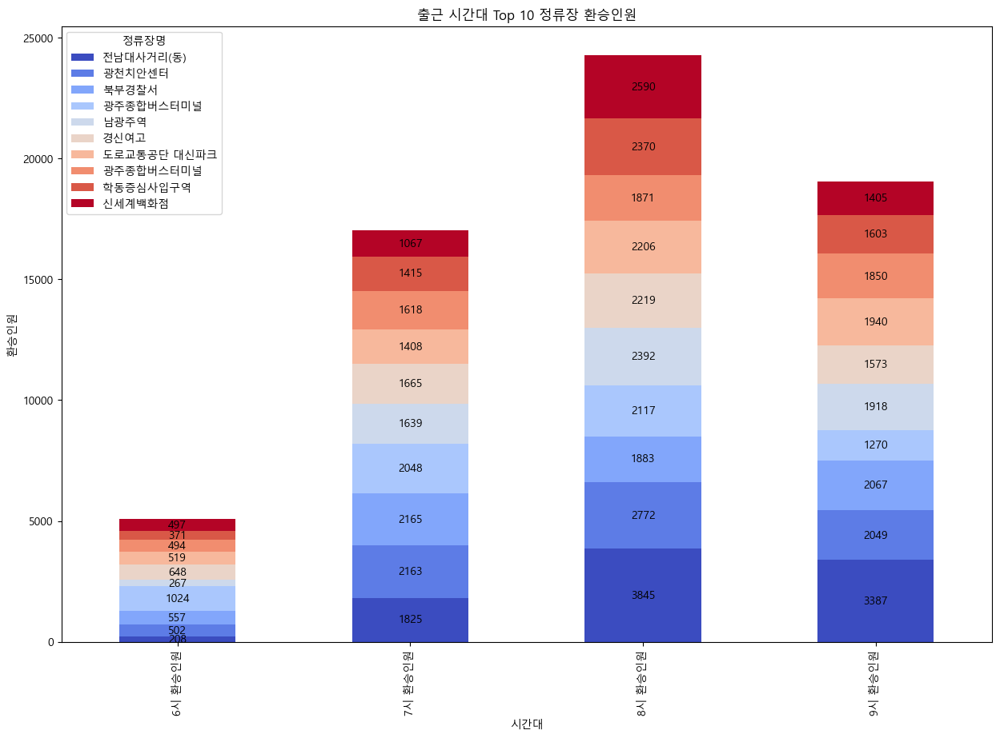

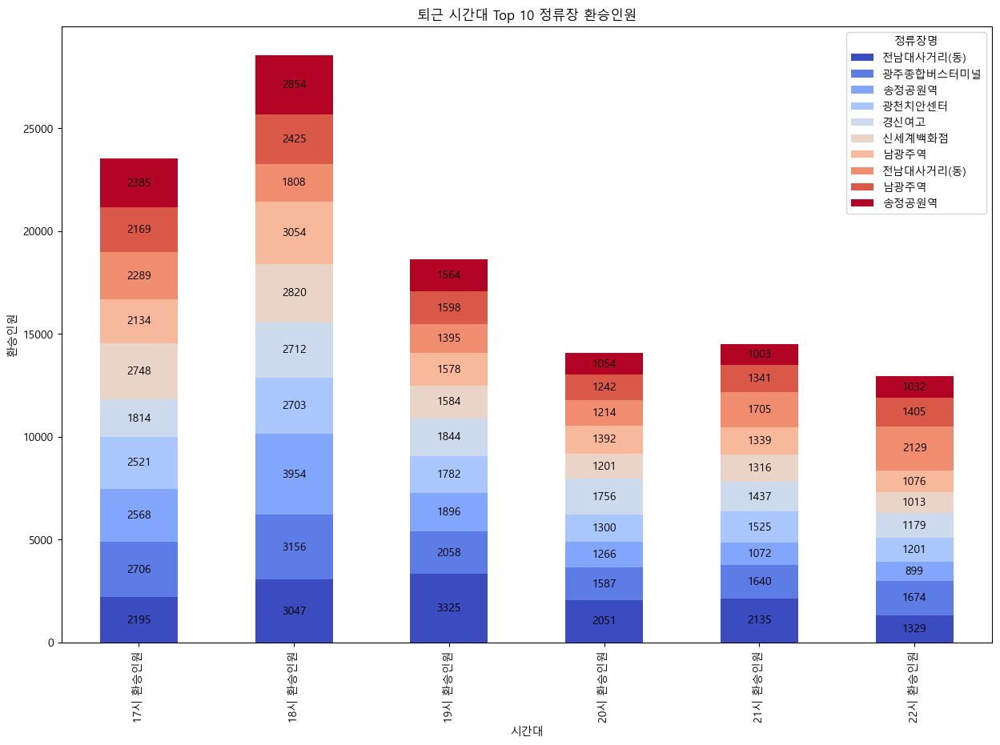

In [40]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import matplotlib.colors as mcolors
import numpy as np

# 한글 폰트 설정
font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우 시스템에서 '맑은 고딕' 폰트 경로
font_name = fm.FontProperties(fname=font_path).get_name()
plt.rc('font', family=font_name)

# 출근 시간과 퇴근 시간 동안의 환승 인원을 계산
transfer_df['출근 시간 총 환승인원'] = transfer_df[['6시 환승인원', '7시 환승인원', '8시 환승인원', '9시 환승인원']].sum(axis=1)
transfer_df['퇴근 시간 총 환승인원'] = transfer_df[['17시 환승인원', '18시 환승인원', '19시 환승인원', '20시 환승인원', '21시 환승인원', '22시 환승인원']].sum(axis=1)

# 출근 시간 기준으로 Top 10 정류장 선정
top_10_morning_transfer = transfer_df.nlargest(10, '출근 시간 총 환승인원')

# 퇴근 시간 기준으로 Top 10 정류장 선정
top_10_evening_transfer = transfer_df.nlargest(10, '퇴근 시간 총 환승인원')

# 색상 설정을 위한 함수
def get_colors(values):
    norm = mcolors.Normalize(vmin=values.min(), vmax=values.max())
    cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", ["gray", "blue"])
    return [cmap(norm(val)) for val in values]

# Top 10 정류장의 시간대별 환승 인원수 시각화
def plot_top_10(df, title):
    df.set_index('정류장명', inplace=True)
    
    if title == '출근 시간대 Top 10 정류장 환승인원':
        columns_to_plot = ['6시 환승인원', '7시 환승인원', '8시 환승인원', '9시 환승인원']
    elif title == '퇴근 시간대 Top 10 정류장 환승인원':
        columns_to_plot = ['17시 환승인원', '18시 환승인원', '19시 환승인원', '20시 환승인원', '21시 환승인원', '22시 환승인원']
    else:
        print("error")
        return
    
    if columns_to_plot:
        ax = df[columns_to_plot].T.plot(kind='bar', stacked=True, figsize=(15, 10), colormap='coolwarm')
        plt.title(title)
        plt.ylabel('환승인원')
        plt.xlabel('시간대')
        plt.legend(title='정류장명')
        
        # 각 막대 위에 텍스트 추가
        for container in ax.containers:
            ax.bar_label(container, label_type='center')
        
        plt.show()

plot_top_10(top_10_morning_transfer, '출근 시간대 Top 10 정류장 환승인원')
plot_top_10(top_10_evening_transfer, '퇴근 시간대 Top 10 정류장 환승인원')


In [42]:
# 출근 시간과 퇴근 시간 동안의 환승 인원을 계산
transfer_df['출근 시간 총 환승인원'] = transfer_df[['6시 환승인원', '7시 환승인원', '8시 환승인원', '9시 환승인원']].sum(axis=1)
transfer_df['퇴근 시간 총 환승인원'] = transfer_df[['17시 환승인원', '18시 환승인원', '19시 환승인원', '20시 환승인원', '21시 환승인원', '22시 환승인원']].sum(axis=1)

# 출근 시간 기준으로 Top 10 정류장 선정
top_10_morning_transfer = transfer_df.nlargest(10, '출근 시간 총 환승인원')

# 퇴근 시간 기준으로 Top 10 정류장 선정
top_10_evening_transfer = transfer_df.nlargest(10, '퇴근 시간 총 환승인원')

# Top 10 정류장의 시간대별 환승 인원수를 표로 표시
def display_top_10_transfer_table(df, title):
    if '출근 시간' in title:
        columns_to_show = ['정류장명', '6시 환승인원', '7시 환승인원', '8시 환승인원', '9시 환승인원', '출근 시간 총 환승인원']
    elif '퇴근 시간' in title:
        columns_to_show = ['정류장명', '17시 환승인원', '18시 환승인원', '19시 환승인원', '20시 환승인원', '21시 환승인원', '22시 환승인원', '퇴근 시간 총 환승인원']
    else:
        columns_to_show = []
    
    if columns_to_show:
        display_df = df[columns_to_show].copy()
        display_df.set_index('정류장명', inplace=True)
        display_df.style.set_caption(title).format(na_rep='-')

        return display_df

# 출근 시간대 Top 10 정류장 표 (환승 인원)
morning_table_transfer = display_top_10_transfer_table(top_10_morning_transfer, '출근 시간대 Top 10 정류장 환승인원')

# 퇴근 시간대 Top 10 정류장 표 (환승 인원)
evening_table_transfer = display_top_10_transfer_table(top_10_evening_transfer, '퇴근 시간대 Top 10 정류장 환승인원')

In [43]:
morning_table_transfer

,6시 환승인원,7시 환승인원,8시 환승인원,9시 환승인원,출근 시간 총 환승인원
정류장명,,,,,
전남대사거리(동),208,1825,3845,3387,9265
광천치안센터,502,2163,2772,2049,7486
북부경찰서,557,2165,1883,2067,6672
광주종합버스터미널,1024,2048,2117,1270,6459
남광주역,267,1639,2392,1918,6216
경신여고,648,1665,2219,1573,6105
도로교통공단 대신파크,519,1408,2206,1940,6073
광주종합버스터미널,494,1618,1871,1850,5833
학동증심사입구역,371,1415,2370,1603,5759


In [44]:
evening_table_transfer

,17시 환승인원,18시 환승인원,19시 환승인원,20시 환승인원,21시 환승인원,22시 환승인원,퇴근 시간 총 환승인원
정류장명,,,,,,,
전남대사거리(동),2195,3047,3325,2051,2135,1329,14082
광주종합버스터미널,2706,3156,2058,1587,1640,1674,12821
송정공원역,2568,3954,1896,1266,1072,899,11655
광천치안센터,2521,2703,1782,1300,1525,1201,11032
경신여고,1814,2712,1844,1756,1437,1179,10742
신세계백화점,2748,2820,1584,1201,1316,1013,10682
남광주역,2134,3054,1578,1392,1339,1076,10573
전남대사거리(동),2289,1808,1395,1214,1705,2129,10540
남광주역,2169,2425,1598,1242,1341,1405,10180


In [52]:
from folium.plugins import MarkerCluster
import folium

# 중심점을 설정 (정류장명이 '구시청사거리'인 정류장의 위도, 경도)
center_lat = getOn_df[getOn_df['정류장명'] == '구시청사거리']['위도'].values[0]
center_lon = getOn_df[getOn_df['정류장명'] == '구시청사거리']['경도'].values[0]

center = [center_lat, center_lon]

# 지도 생성
m = folium.Map(location=center, zoom_start=11)

# 색상 설정 함수
def get_color(type):
    if type == '승차':
        return 'blue'
    elif type == '하차':
        return 'red'
    elif type == '환승':
        return 'purple'

# 출근 시간대 기준으로 Top 10 정류장 선정
top_10_morning_on = getOn_df.nlargest(10, '출근 시간 총 승차인원')
top_10_morning_off = getOff_df.nlargest(10, '출근 시간 총 하차인원')
top_10_morning_transfer = transfer_df.nlargest(10, '출근 시간 총 환승인원')

# 데이터 준비 및 마커 추가
# 승차 데이터
for index, row in top_10_morning_on.iterrows():
    folium.Marker(
        location=(row['위도'], row['경도']),
        icon=folium.Icon(color='blue', icon='info-sign'),
        popup=(
            f"<strong>정류장명:</strong> {row['정류장명']}<br>"
            f"<strong>출근 시간 총 승차인원:</strong> {row['출근 시간 총 승차인원']}명<br>"
            f"<strong>유형:</strong> 승차<br>"
        ),
        tooltip='승차'
    ).add_to(m)

# 하차 데이터
for index, row in top_10_morning_off.iterrows():
    folium.Marker(
        location=(row['위도'], row['경도']),
        icon=folium.Icon(color='red', icon='info-sign'),
        popup=(
            f"<strong>정류장명:</strong> {row['정류장명']}<br>"
            f"<strong>출근 시간 총 하차인원:</strong> {row['출근 시간 총 하차인원']}명<br>"
            f"<strong>유형:</strong> 하차<br>"
        ),
        tooltip='하차'
    ).add_to(m)

# 환승 데이터
for index, row in top_10_morning_transfer.iterrows():
    folium.Marker(
        location=(row['위도'], row['경도']),
        icon=folium.Icon(color='purple', icon='info-sign'),
        popup=(
            f"<strong>정류장명:</strong> {row['정류장명']}<br>"
            f"<strong>출근 시간 총 환승인원:</strong> {row['출근 시간 총 환승인원']}명<br>"
            f"<strong>유형:</strong> 환승<br>"
        ),
        tooltip='환승'
    ).add_to(m)


# 지도 저장
m.save('2024 출근 시간대 승차 하차 환승 인원 포화상태.html')

m
